In [1]:
import numpy as np

from energy import energy_gradient, energy_function_forward, gradient_magnitude_sobel_operator
from seams import seams_map_dp, seam_map_function_forward, carve_column_mask
from seam_carve import SeamCarve, get_importance_map_from_borders
from utils import get_config

from PIL import Image
from matplotlib import pyplot as plt
import os

In [2]:
config = get_config()
config

{'dataset_dir': '/home/mariiak/Documents/UCU/SeamCarving/dataset_500',
 'output_dir': '/home/mariiak/Documents/UCU/SeamCarving/images',
 'gifs_dir': '/home/mariiak/Documents/UCU/SeamCarving/gifs',
 'stats_dir': '/home/mariiak/Documents/UCU/SeamCarving/stats',
 'pool_processes': 4}

## Original image

Original size: (339, 500, 3)


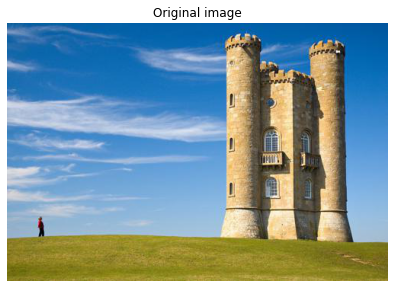

In [3]:
img_name = 'castle.jpg'
img_path = os.path.join(config['dataset_dir'], img_name)

img = Image.open(img_path)
print('Original size:', np.array(img).shape)

plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(img)
plt.axis(False)
plt.title('Original image')
plt.show()

## Using seam carving for size reduction

New size: (339, 400)


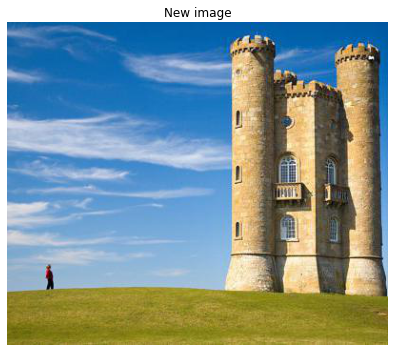


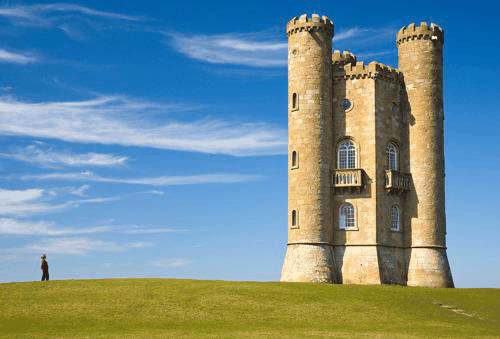

In [4]:
new_size = (339, 400)
print('New size:', new_size)

seam_carve_energy_gradient = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_gradient,
    seam_map_function=seams_map_dp,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='energy_gradient',
    save_gif=True
)

seam_carve_energy_gradient.run()
new_img_path, gif_path = seam_carve_energy_gradient.save_result()

new_img = Image.open(new_img_path)
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(new_img)
plt.axis(False)
plt.title('New image')
plt.show()

seam_carve_energy_gradient.show_gif()

## Using seam carving for image extension

New size: (339, 600)


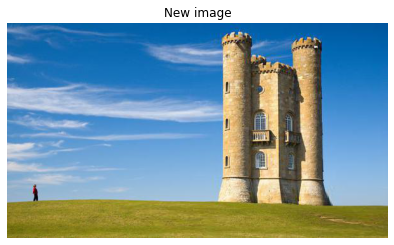


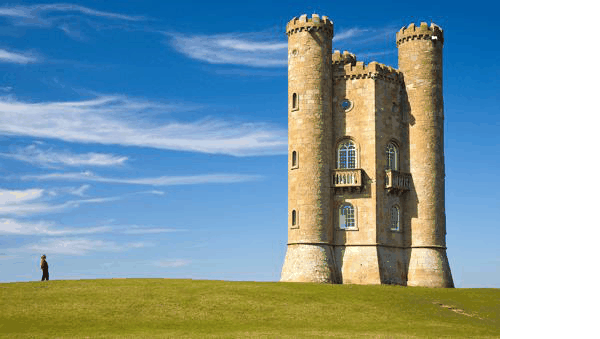

In [5]:
new_size = (339, 600)
print('New size:', new_size)

seam_carve_energy_gradient = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_gradient,
    seam_map_function=seams_map_dp,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='energy_gradient',
    save_gif=True
)

seam_carve_energy_gradient.run()
new_img_path, gif_path = seam_carve_energy_gradient.save_result()

new_img = Image.open(new_img_path)
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(new_img)
plt.axis(False)
plt.title('New image')
plt.show()

seam_carve_energy_gradient.show_gif()

## Different energy functions

Original size: (374, 499, 3)


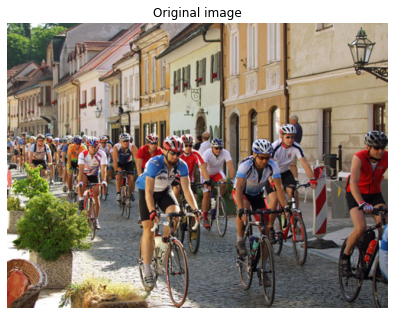

In [6]:
img_name = 'bicycle2.png'
img_path = os.path.join(config['dataset_dir'], img_name)

img = Image.open(img_path)
print('Original size:', np.array(img).shape)

plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(img)
plt.axis(False)
plt.title('Original image')
plt.show()

In [7]:
new_size = (300, 499)
print('New size:', new_size)

seam_carve = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_gradient,
    seam_map_function=seams_map_dp,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='energy_gradient',
    save_gif=False
)

seam_carve.run()
new_img_path_energy_gradient, _ = seam_carve.save_result()

seam_carve = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_function_forward,
    seam_map_function=seam_map_function_forward,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='forward_energy',
    save_gif=False
)

seam_carve.run()
new_img_path_energy_forward, _ = seam_carve.save_result()

seam_carve = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=gradient_magnitude_sobel_operator,
    seam_map_function=seams_map_dp,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='energy_sobel',
    save_gif=False
)

seam_carve.run()
new_img_path_energy_sobel, _ = seam_carve.save_result()

New size: (300, 499)


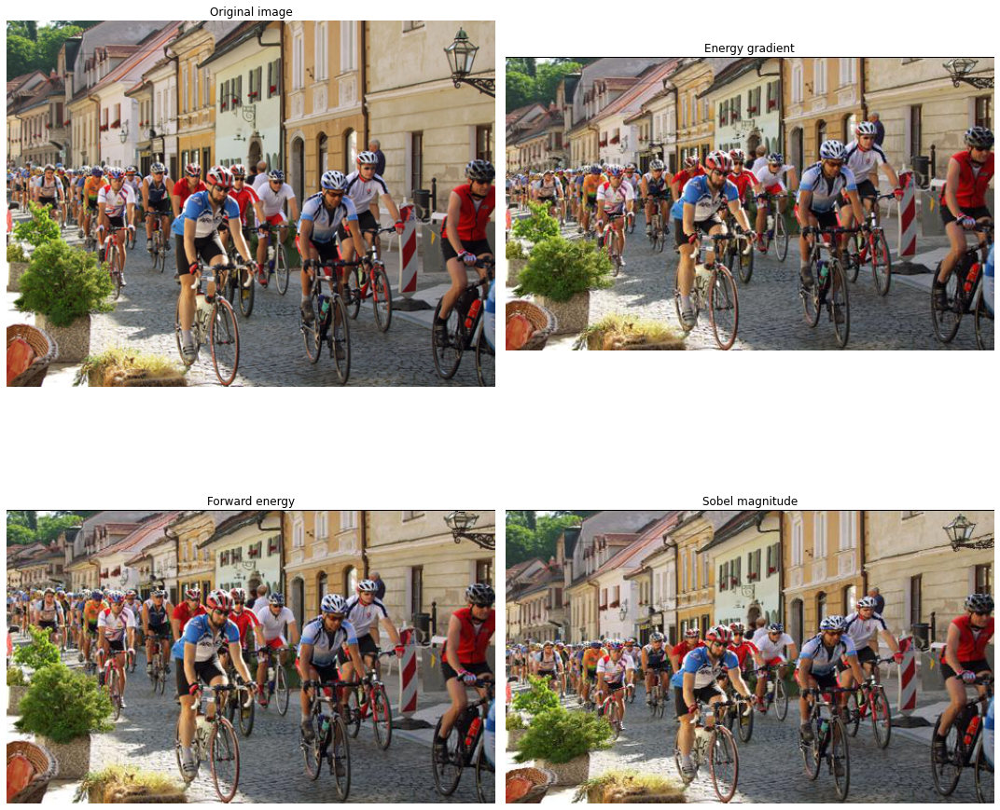

In [8]:
plt.figure(figsize=(15,15))

plt.subplot(221)
plt.imshow(Image.open(img_path))
plt.axis(False)
plt.title('Original image')

plt.subplot(222)
plt.imshow(Image.open(new_img_path_energy_gradient))
plt.axis(False)
plt.title('Energy gradient')

plt.subplot(223)
plt.imshow(Image.open(new_img_path_energy_forward))
plt.axis(False)
plt.title('Forward energy')

plt.subplot(224)
plt.imshow(Image.open(new_img_path_energy_sobel))
plt.axis(False)
plt.title('Sobel magnitude')

plt.tight_layout()

plt.show()

## Object input

Original size: (500, 500, 3)


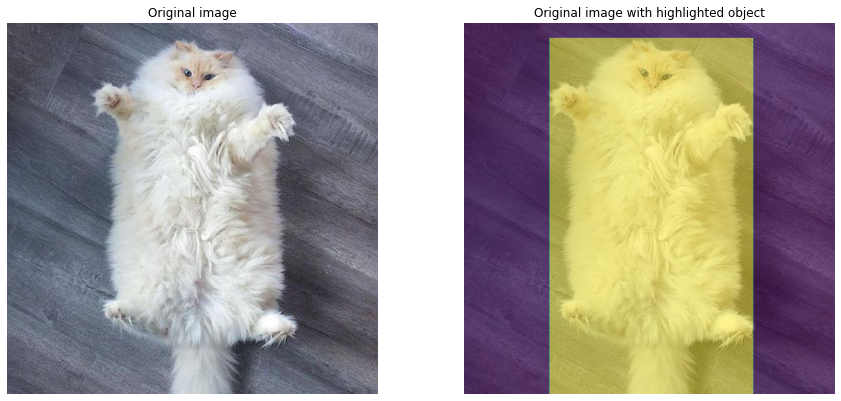

In [9]:
img_name = 'cat.jpg'
img_path = os.path.join(config['dataset_dir'], img_name)

img = Image.open(img_path)
print('Original size:', np.array(img).shape)

upper = 0.04
bottom = 1
left = 0.23
right = 0.78

importance_map = get_importance_map_from_borders(img, upper, bottom, left, right)
importance_map_img = Image.fromarray(np.uint8(importance_map), 'L')

plt.figure(figsize=(15,15))

plt.subplot(221)
plt.imshow(img)
plt.axis(False)
plt.title('Original image')

plt.subplot(222)
plt.imshow(img)
plt.axis(False)
plt.imshow(importance_map_img, alpha=.5)
plt.axis(False)
plt.title('Original image with highlighted object')

plt.show()

In [11]:
new_size = (500, 450)

seam_carve = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_function_forward,
    seam_map_function=seam_map_function_forward,
    carve_function=carve_column_mask,
    importance_map=None,
    name_suffix='forward_energy',
    save_gif=False
)

seam_carve.run()
new_img_path, _ = seam_carve.save_result()

seam_carve = SeamCarve(
    image_path=img_path,
    new_size=new_size,
    energy_function=energy_function_forward,
    seam_map_function=seam_map_function_forward,
    carve_function=carve_column_mask,
    importance_map=importance_map,
    name_suffix='forward_energy_with_object_map',
    save_gif=False
)
seam_carve.run()
new_img_path_with_object_map, _ = seam_carve.save_result()

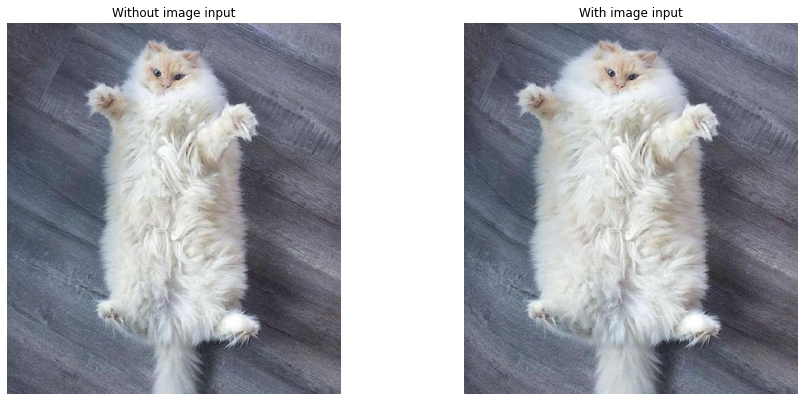

In [12]:
plt.figure(figsize=(15,15))

plt.subplot(221)
plt.imshow(Image.open(new_img_path))
plt.axis(False)
plt.title('Without image input')

plt.subplot(222)
plt.imshow(Image.open(new_img_path_with_object_map))
plt.axis(False)
plt.title('With image input')

plt.show()